In [ ]:
# !pip install pandas-profiling==3.4.0

In [ ]:
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, KFold
from sklearn.linear_model import LogisticRegressionCV
from sklearn.metrics import classification_report, accuracy_score, make_scorer
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import KFold
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.decomposition import PCA
from sklearn.datasets import make_multilabel_classification
from sklearn.multiclass import OneVsRestClassifier
from sklearn import set_config
from sklearn.datasets import fetch_openml
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from hyperopt import hp, fmin, tpe, Trials, STATUS_OK

from sklearn.impute import SimpleImputer
from sklearn.impute import MissingIndicator
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler, Normalizer
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.compose import ColumnTransformer
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.feature_selection import VarianceThreshold

import pandas_profiling
import pandas as pd
import numpy as np
import math
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import product
import scipy.stats as ss
from scipy.stats import chi2
from scipy.spatial.distance import pdist, mahalanobis, squareform
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import plotly.express as px
import plotly

from sklearn.datasets import make_classification
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from matplotlib import pyplot

from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.svm import OneClassSVM
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.metrics import davies_bouldin_score, calinski_harabasz_score
from sklearn.decomposition import PCA, TruncatedSVD, NMF
from sklearn import set_config

import sys

import warnings
warnings.simplefilter("ignore")

seed = 42

In [ ]:
#@title Function for Confusion Matrix Visualisation
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def make_confusion_matrix(cf,
                          group_names=None,
                          categories='auto',
                          count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html

    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)

    if title:
        plt.title(title)

# Data Preparation

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
path = "/content/drive/MyDrive/EPAM_Data_Science/Homeworks/HW8.2/data/Cardiotocography.csv"
data = pd.read_csv(path, sep=",") # , index_col="id")
data

,id,LB,AC,FM,UC,ASTV,MSTV,ALTV,MLTV,DL,...,Min,Max,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency,outlier
0,1881.0,0.592593,0.000000,0.000000,0.294118,0.633803,0.338235,0.000000,0.013807,0.500000,...,0.045872,0.336207,0.333333,0.1,0.485149,0.247423,0.284091,0.638418,1.0,b'yes'
1,421.0,0.574074,0.038462,0.000000,0.000000,0.816901,0.029412,0.527473,0.092702,0.000000,...,0.770642,0.672414,0.166667,0.0,0.534653,0.587629,0.511364,0.016949,0.0,b'yes'
2,92.0,0.777778,0.000000,0.000000,0.000000,0.774648,0.029412,0.736264,0.096647,0.000000,...,0.816514,0.275862,0.222222,0.0,0.633663,0.659794,0.602273,0.000000,1.0,b'yes'
3,1767.0,0.259259,0.000000,0.000000,0.294118,0.704225,0.191176,0.000000,0.183432,0.428571,...,0.174312,0.275862,0.222222,0.1,0.000000,0.164948,0.000000,0.361582,0.0,b'yes'
4,1880.0,0.592593,0.000000,0.001773,0.294118,0.633803,0.352941,0.000000,0.013807,0.428571,...,0.045872,0.336207,0.333333,0.1,0.485149,0.226804,0.272727,0.683616,1.0,b'yes'
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16875,2118.0,0.629630,0.000000,0.000000,0.352941,0.893333,0.014706,0.253165,0.167653,0.000000,...,0.678899,0.241379,0.055556,0.0,0.641667,0.642202,0.563830,0.005650,1.0,b'no'
16876,2119.0,0.629630,0.000000,0.000000,0.411765,0.893333,0.044118,0.329114,0.138067,0.071429,...,0.724771,0.241379,0.055556,0.0,0.650000,0.633028,0.563830,0.011299,1.0,b'no'
16877,2120.0,0.629630,0.000000,0.000000,0.352941,0.893333,0.058824,0.341772,0.126233,0.071429,...,0.678899,0.241379,0.055556,0.0,0.641667,0.623853,0.563830,0.005650,1.0,b'no'
16878,2121.0,0.629630,0.000000,0.000000,0.235294,0.866667,0.073529,0.215190,0.118343,0.071429,...,0.678899,0.284483,0.111111,0.0,0.650000,0.642202,0.563830,0.011299,0.5,b'no'


In [ ]:
print(data.shape)
print(data.dtypes.value_counts())
print(data.dtypes)

(16880, 23)
float64    22
object      1
dtype: int64
id          float64
LB          float64
AC          float64
FM          float64
UC          float64
ASTV        float64
MSTV        float64
ALTV        float64
MLTV        float64
DL          float64
DS          float64
DP          float64
Width       float64
Min         float64
Max         float64
Nmax        float64
Nzeros      float64
Mode        float64
Mean        float64
Median      float64
Variance    float64
Tendency    float64
outlier      object
dtype: object


In [ ]:
print(data.isnull().sum().sum())

0


No missing values.

In [ ]:
used_features = data.columns

data['is_duplicated'] = data.duplicated(used_features)
print(data['is_duplicated'].sum())
data = data.drop(["is_duplicated"], axis=1)

0


No duplicates in the data.

In [ ]:
data['id'] = data['id'].astype(int)
data['outlier'] = data['outlier'].apply(lambda x: -1 if x == "b'yes'" else 1)

In [ ]:
data

,id,LB,AC,FM,UC,ASTV,MSTV,ALTV,MLTV,DL,...,Min,Max,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency,outlier
0,1881,0.592593,0.000000,0.000000,0.294118,0.633803,0.338235,0.000000,0.013807,0.500000,...,0.045872,0.336207,0.333333,0.1,0.485149,0.247423,0.284091,0.638418,1.0,-1
1,421,0.574074,0.038462,0.000000,0.000000,0.816901,0.029412,0.527473,0.092702,0.000000,...,0.770642,0.672414,0.166667,0.0,0.534653,0.587629,0.511364,0.016949,0.0,-1
2,92,0.777778,0.000000,0.000000,0.000000,0.774648,0.029412,0.736264,0.096647,0.000000,...,0.816514,0.275862,0.222222,0.0,0.633663,0.659794,0.602273,0.000000,1.0,-1
3,1767,0.259259,0.000000,0.000000,0.294118,0.704225,0.191176,0.000000,0.183432,0.428571,...,0.174312,0.275862,0.222222,0.1,0.000000,0.164948,0.000000,0.361582,0.0,-1
4,1880,0.592593,0.000000,0.001773,0.294118,0.633803,0.352941,0.000000,0.013807,0.428571,...,0.045872,0.336207,0.333333,0.1,0.485149,0.226804,0.272727,0.683616,1.0,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16875,2118,0.629630,0.000000,0.000000,0.352941,0.893333,0.014706,0.253165,0.167653,0.000000,...,0.678899,0.241379,0.055556,0.0,0.641667,0.642202,0.563830,0.005650,1.0,1
16876,2119,0.629630,0.000000,0.000000,0.411765,0.893333,0.044118,0.329114,0.138067,0.071429,...,0.724771,0.241379,0.055556,0.0,0.650000,0.633028,0.563830,0.011299,1.0,1
16877,2120,0.629630,0.000000,0.000000,0.352941,0.893333,0.058824,0.341772,0.126233,0.071429,...,0.678899,0.241379,0.055556,0.0,0.641667,0.623853,0.563830,0.005650,1.0,1
16878,2121,0.629630,0.000000,0.000000,0.235294,0.866667,0.073529,0.215190,0.118343,0.071429,...,0.678899,0.284483,0.111111,0.0,0.650000,0.642202,0.563830,0.011299,0.5,1


# 1. EDA

In [ ]:
report = pandas_profiling.ProfileReport(data)

In [ ]:
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

This part can be used to delete features that contain too many 0 values, I will leave them as in this case our output classes are also highly imbalaced, so these feature still may be useful.

In [ ]:
# if "FM" in data.columns:
#   data = data.drop(["FM"], axis=1)
# if "ALTV" in data.columns:
#   data = data.drop(["ALTV"], axis=1)
# if "DL" in data.columns:
#   data = data.drop(["DL"], axis=1)
# if "DS" in data.columns:
#   data = data.drop(["DS"], axis=1)

['id', 'LB', 'AC', 'FM', 'UC', 'ASTV', 'MSTV', 'ALTV', 'MLTV', 'DL', 'DS', 'DP', 'Width', 'Min', 'Max', 'Nmax', 'Nzeros', 'Mode', 'Mean', 'Median', 'Variance', 'Tendency']


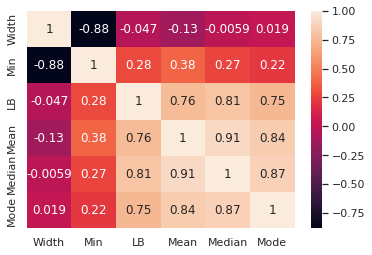

In [ ]:
top_corr_cols = []
cols = list(data.columns)
cols.remove('outlier')
print(cols)
for col in cols:
  corr = data.corr()
  condition = np.absolute(corr[col]) > 0.8
  top_corr = corr.loc[condition,condition]
  col_list = list(top_corr.columns)
  col_list.remove(col)
  top_corr_cols += col_list
top_corr_cols = set(top_corr_cols)
top_corr_cols = list(top_corr_cols)
corr = data[top_corr_cols].corr()
sns.heatmap(corr, annot=True);

Text I will also delete the features that are extremely correlated.

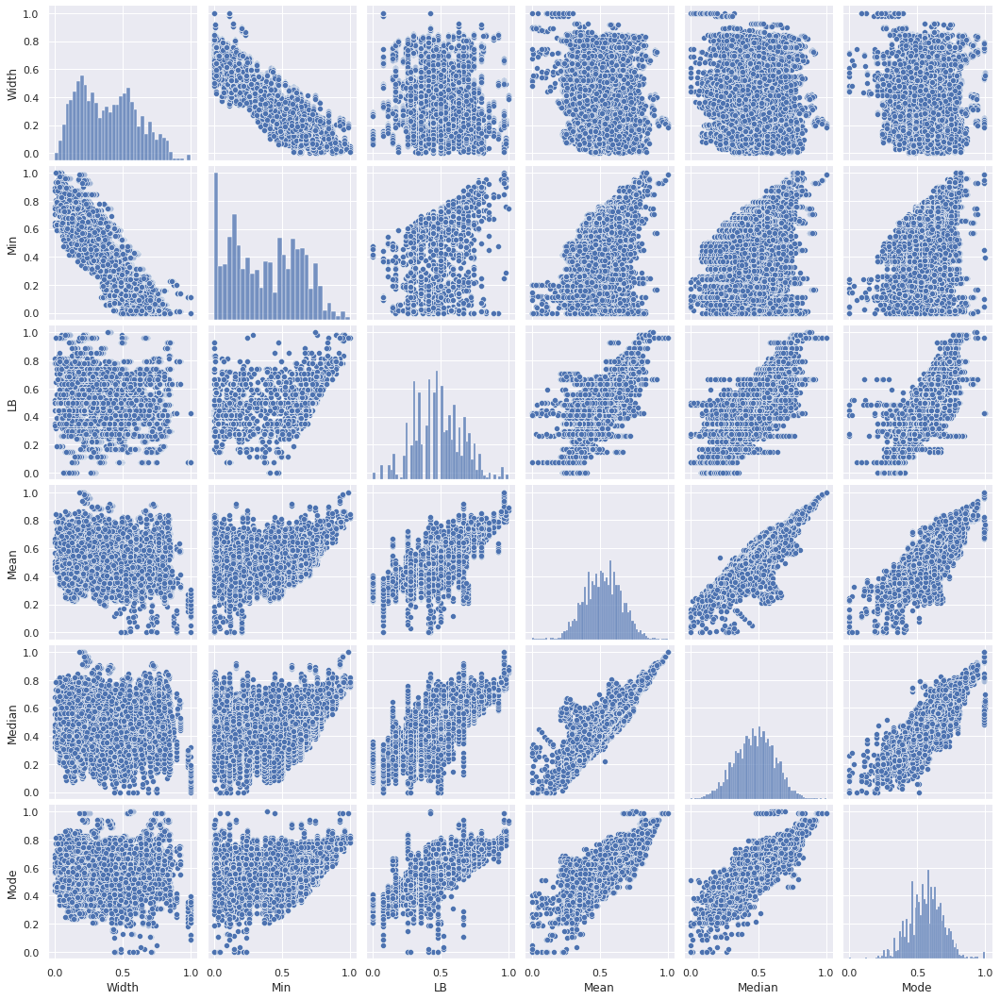

In [ ]:
pairwise_plots = sns.pairplot(data[top_corr_cols])

This part can be used to delete highly correlated features, I will leave them as I got sightly better results with them.

In [ ]:
# if "Width" in data.columns:
#   data = data.drop(["Width"], axis=1)
# if "LB" in data.columns:
#   data = data.drop(["LB"], axis=1)
# if "Mode" in data.columns:
#   data = data.drop(["Mode"], axis=1)
# if "Mean" in data.columns:
#   data = data.drop(["Mean"], axis=1)

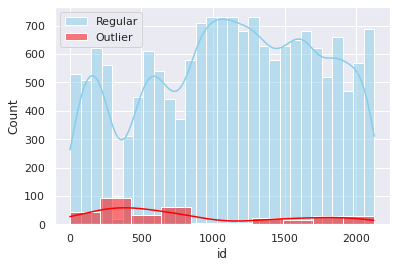

In [ ]:
sns.set(style="darkgrid")

sns.histplot(data=data[data['outlier'] == 1], x="id", color="skyblue", label="Regular", kde=True)
sns.histplot(data=data[data['outlier'] == -1], x="id", color="red", label="Outlier", kde=True)

plt.legend()
plt.show()

We can see that ids are have a strage distribution between the classes, so it can be a useful feature as it contains information about the classes, probably this resembles correlation with time, however we do not have time information.

In [ ]:
print(data[data['outlier'] == 1]["id"].describe(include="all"))
print(data[data['outlier'] == -1]["id"].describe(include="all"))

count    16550.000000
mean      1129.971601
std        591.026353
min          2.000000
25%        660.000000
50%       1157.000000
75%       1621.000000
max       2126.000000
Name: id, dtype: float64
count     330.000000
mean      817.975758
std       641.658257
min         1.000000
25%       327.000000
50%       634.000000
75%      1427.500000
max      2123.000000
Name: id, dtype: float64


In [ ]:
print(len(np.unique(data[data['outlier'] == 1]["id"])))
print(len(np.unique(data[data['outlier'] == -1]["id"])))
print(len(np.unique(data["id"])))

1655
247
1902


Sadly here we can see that the for each id the classes are either 1 or -1 meaning this will result to a data leakage for supervised methods. Maybe it could be normalized and used in unsupervised methods still would be very little use of it as the new inputs for later usage of the model will probably have higher ids and the id feature will rather become an issue for the model.

In [ ]:
if "id" in data.columns:
  data = data.drop(["id"], axis=1)

In [ ]:
data.describe(include="all")

,LB,AC,FM,UC,ASTV,MSTV,ALTV,MLTV,DL,DS,...,Min,Max,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency,outlier
count,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,...,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000
mean,0.483186,0.129270,0.011411,0.226668,0.425672,0.179521,0.064739,0.170819,0.113227,0.000770,...,0.379411,0.365604,0.230579,0.033365,0.563887,0.525497,0.475086,0.090984,0.670794,0.960900
std,0.175738,0.143077,0.060514,0.156665,0.216970,0.121198,0.146732,0.114551,0.171935,0.027742,...,0.252147,0.153285,0.159211,0.069209,0.128429,0.136375,0.146790,0.119737,0.295171,0.276902
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000
25%,0.351852,0.000000,0.000000,0.117647,0.236111,0.088235,0.000000,0.094675,0.000000,0.000000,...,0.155963,0.258621,0.111111,0.000000,0.482143,0.431193,0.373494,0.015385,0.500000,1.000000
50%,0.481481,0.076923,0.000000,0.235294,0.408451,0.161765,0.000000,0.155819,0.000000,0.000000,...,0.376147,0.353448,0.222222,0.000000,0.567797,0.525773,0.478261,0.045198,0.500000,1.000000
75%,0.592593,0.192308,0.003546,0.304348,0.608108,0.220588,0.050633,0.226824,0.214286,0.000000,...,0.596330,0.456897,0.333333,0.000000,0.650000,0.621053,0.576087,0.122677,1.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


# 2. Feature Engineering

## 2.2 Non-Linear Transformations

In [ ]:
y = data["outlier"]
X = data.drop(["outlier"], axis=1)

In [ ]:
initial_columns = list(X.columns)

In [ ]:
poly = PolynomialFeatures(2)
X_poly = poly.fit_transform(X)
poly_columns = poly.get_feature_names_out(X.columns)
X_poly = pd.DataFrame(X_poly, columns=poly_columns)

In [ ]:
for col in initial_columns:
  X_poly[f"{col}_log"] = X[col].apply(lambda x: math.log(1+x,2))
for col in initial_columns:
  X_poly[f"{col}_log"] = X[col].apply(lambda x: math.sqrt(x))

## 2.2 Train test split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=seed,
                                                    test_size = 0.25,
                                                    shuffle=True)

In [ ]:
X_train_poly, X_test_poly, y_train_poly, y_test_poly = train_test_split(X_poly, y, random_state=seed,
                                                    test_size = 0.25,
                                                    shuffle=True)

# 3. Mahalanobis Distance and Tukey Rule

## 3.1 Mahalanobis Distance

In [ ]:
covariance_inverse = np.linalg.inv(np.cov(X.T))
mean_vector = X.mean(axis=0)

bias_distance = X.apply(lambda row:
                             mahalanobis(mean_vector, row, VI=covariance_inverse),
                             axis=1)

In [ ]:
print(bias_distance.sort_values())
bias_distance.describe(include="all")

3958      1.696634
3957      1.705357
14085     1.731319
14086     1.770138
3959      1.773307
           ...    
12972    36.151743
16348    36.165469
6220     36.270855
15220    37.073156
1719     37.074306
Length: 16880, dtype: float64


count    16880.000000
mean         4.223198
std          1.778635
min          1.696634
25%          3.241754
50%          3.840492
75%          4.728931
max         37.074306
dtype: float64

In [ ]:
for i in range(14, 5, -1):
    predictions = np.ones(X.shape[0])
    predictions[bias_distance > i] = -1

    silhouette_sc = silhouette_score(X, predictions)
    db_sc = davies_bouldin_score(X, predictions)
    ch_sc = calinski_harabasz_score(X, predictions)
    outlier_percentage = np.count_nonzero(predictions == -1)/np.count_nonzero(predictions != 0)
    print(
        "For Mahalanobis Rule :", i,
        "\nThe metrics are",
        "\nOutlier percentage is :", outlier_percentage,
        "\nSilhouette score is :", silhouette_sc,
        "\nDavies Bouldin score is :", db_sc,
        "\nCalinski Harabasz score is :", ch_sc
    )

For Mahalanobis Rule : 14 
The metrics are 
Outlier percentage is : 0.003909952606635071 
Silhouette score is : 0.3445916704185488 
Davies Bouldin score is : 1.9146969429184428 
Calinski Harabasz score is : 94.55328133617104
For Mahalanobis Rule : 13 
The metrics are 
Outlier percentage is : 0.004917061611374407 
Silhouette score is : 0.34586614328036686 
Davies Bouldin score is : 2.0245154792790663 
Calinski Harabasz score is : 112.42035519540438
For Mahalanobis Rule : 12 
The metrics are 
Outlier percentage is : 0.005272511848341232 
Silhouette score is : 0.34419395253445756 
Davies Bouldin score is : 2.054839026881232 
Calinski Harabasz score is : 117.92481840258584
For Mahalanobis Rule : 11 
The metrics are 
Outlier percentage is : 0.006101895734597156 
Silhouette score is : 0.33764634650421754 
Davies Bouldin score is : 2.1349565730741995 
Calinski Harabasz score is : 127.57111887554308
For Mahalanobis Rule : 10 
The metrics are 
Outlier percentage is : 0.00924170616113744 
Silhou

Here we can see that the Silhouette score at its peak when we have minimal amount of outliers, thus I belive it is not the best model for our purpose.

## 3.2 Tukey Rule

In [ ]:
def define_outlier(df_in, col_name, k, predictions):
    df = df_in.copy()
    q1 = df[col_name].quantile(0.25)
    q3 = df[col_name].quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-k*iqr
    fence_high = q3+k*iqr
    predictions[df[col_name] < fence_low] = -1
    predictions[df[col_name] > fence_high] = -1
    return predictions

def define_outlier_dataframe(df_in, k):
  predictions = np.ones(df_in.shape[0])
  for col in list(df_in.columns):
    predictions = define_outlier(df_in, col, k, predictions)
  return predictions

In [ ]:
for i in np.arange(1000, 3000, 500):
    predictions = define_outlier_dataframe(X, i)

    silhouette_sc = silhouette_score(X, predictions)
    db_sc = davies_bouldin_score(X, predictions)
    ch_sc = calinski_harabasz_score(X, predictions)
    outlier_percentage = np.count_nonzero(predictions == -1)/np.count_nonzero(predictions != 0)
    print(
        "For Tukey Rule :", i,
        "\nThe metrics are",
        "\nOutlier percentage is :", outlier_percentage,
        "\nSilhouette score is :", silhouette_sc,
        "\nDavies Bouldin score is :", db_sc,
        "\nCalinski Harabasz score is :", ch_sc
    )

For Tukey Rule : 1000 
The metrics are 
Outlier percentage is : 0.2787322274881517 
Silhouette score is : 0.06532123079802184 
Davies Bouldin score is : 3.681631496764998 
Calinski Harabasz score is : 939.9481067299964
For Tukey Rule : 1500 
The metrics are 
Outlier percentage is : 0.2787322274881517 
Silhouette score is : 0.06532123079802184 
Davies Bouldin score is : 3.681631496764998 
Calinski Harabasz score is : 939.9481067299964
For Tukey Rule : 2000 
The metrics are 
Outlier percentage is : 0.2787322274881517 
Silhouette score is : 0.06532123079802184 
Davies Bouldin score is : 3.681631496764998 
Calinski Harabasz score is : 939.9481067299964
For Tukey Rule : 2500 
The metrics are 
Outlier percentage is : 0.2787322274881517 
Silhouette score is : 0.06532123079802184 
Davies Bouldin score is : 3.681631496764998 
Calinski Harabasz score is : 939.9481067299964


I tried Tukey Rule for outlier detection with very different values of k that is multiplier of interquartile range. However even for extremely high values of k, I get 27.8 percent of data detected as outliers. This I think is the result of either very small interquartile range or very extrem data points that are near max. However, I can conclude that this method is not the best for our data.
For futher improvement of the method we might look at subsample of feature only and try to find the one with the best results.

# 4. Supervised Models

## 4.1 SVM

### Base Model

In [ ]:
# Variables for average classification report
originalclass_lr = []
predictedclass_lr = []

#Make our custom score
def classification_report_with_accuracy_score(y_true, y_pred):
    originalclass_lr.extend(y_true)
    predictedclass_lr.extend(y_pred)
    return accuracy_score(y_true, y_pred) # return accuracy score

outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=seed)

clf = SVC(random_state=seed)

# Nested CV with parameter optimization
nested_score = cross_val_score(clf, X=X_train, y=y_train, cv=outer_cv, scoring=make_scorer(classification_report_with_accuracy_score))

# Average values in classification report for all folds in a K-fold Cross-validation
print(classification_report(originalclass_lr, predictedclass_lr))

              precision    recall  f1-score   support

          -1       1.00      0.40      0.57       246
           1       0.99      1.00      0.99     12414

    accuracy                           0.99     12660
   macro avg       0.99      0.70      0.78     12660
weighted avg       0.99      0.99      0.99     12660



### Hyperparameter Tuning

Here I will do hyperparameter tunning with both train sets, regular and the one with none-linear transformations and will chose the best model. As the metric I will use the f1-score macro average as the data is highly imbalanced. We can also choose to use f2-score if we want to give more importance to recall.

In [ ]:
%%time

def objective(space):
    params = {
        'C': float('{:.3f}'.format(space['C'])),
        'kernel': space['kernel'],
        'degree' : int(space['degree']),
        'probability': space['probability']
    }

    clf = SVC(
        random_state=seed,
        **params
    )

    skf = StratifiedKFold(n_splits=5)
    score = cross_val_score(clf, X_train, y_train, scoring='f1_macro', cv=skf).mean()
    print("f1_macro {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
        'C': hp.uniform('learning_rate', 0.005, 1.0),
        'kernel': hp.choice('kernel', ['linear', 'poly', 'rbf']),
        'degree': hp.choice('degree', [2,3,4]),
        'probability':hp.choice('probability', [True])
        }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

f1_macro 0.495 params {'C': 0.162, 'kernel': 'linear', 'degree': 3, 'probability': True}
f1_macro 0.812 params {'C': 0.774, 'kernel': 'poly', 'degree': 3, 'probability': True}
f1_macro 0.780 params {'C': 0.894, 'kernel': 'rbf', 'degree': 4, 'probability': True}
f1_macro 0.770 params {'C': 0.208, 'kernel': 'poly', 'degree': 3, 'probability': True}
f1_macro 0.772 params {'C': 0.796, 'kernel': 'rbf', 'degree': 4, 'probability': True}
f1_macro 0.850 params {'C': 0.487, 'kernel': 'poly', 'degree': 4, 'probability': True}
f1_macro 0.560 params {'C': 0.885, 'kernel': 'linear', 'degree': 2, 'probability': True}
f1_macro 0.519 params {'C': 0.567, 'kernel': 'linear', 'degree': 4, 'probability': True}
f1_macro 0.790 params {'C': 0.36, 'kernel': 'poly', 'degree': 3, 'probability': True}
f1_macro 0.587 params {'C': 0.222, 'kernel': 'rbf', 'degree': 3, 'probability': True}
100%|██████████| 10/10 [01:30<00:00,  9.02s/it, best loss: 0.14952517952111233]
CPU times: user 1min 23s, sys: 141 ms, total: 1m

In [ ]:
%%time

def objective(space):
    params = {
        'C': float('{:.3f}'.format(space['C'])),
        'kernel': space['kernel'],
        'degree' : int(space['degree']),
        'probability': space['probability']
    }

    clf = SVC(
        random_state=seed,
        **params
    )

    skf = StratifiedKFold(n_splits=5)
    score = cross_val_score(clf, X_train_poly, y_train_poly, scoring='f1_macro', cv=skf).mean()
    print("f1_macro {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
        'C': hp.uniform('learning_rate', 0.005, 1.0),
        'kernel': hp.choice('kernel', ['linear', 'poly', 'rbf']),
        'degree': hp.choice('degree', [2,3,4]),
        'probability':hp.choice('probability', [True])
        }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

f1_macro 0.785 params {'C': 0.919, 'kernel': 'rbf', 'degree': 2, 'probability': True}
f1_macro 0.770 params {'C': 0.287, 'kernel': 'linear', 'degree': 4, 'probability': True}
f1_macro 0.789 params {'C': 0.621, 'kernel': 'linear', 'degree': 2, 'probability': True}
f1_macro 0.495 params {'C': 0.005, 'kernel': 'linear', 'degree': 4, 'probability': True}
f1_macro 0.495 params {'C': 0.089, 'kernel': 'rbf', 'degree': 4, 'probability': True}
f1_macro 0.715 params {'C': 0.423, 'kernel': 'rbf', 'degree': 2, 'probability': True}
f1_macro 0.767 params {'C': 0.707, 'kernel': 'rbf', 'degree': 3, 'probability': True}
f1_macro 0.793 params {'C': 0.899, 'kernel': 'linear', 'degree': 3, 'probability': True}
f1_macro 0.793 params {'C': 0.831, 'kernel': 'linear', 'degree': 4, 'probability': True}
f1_macro 0.495 params {'C': 0.113, 'kernel': 'rbf', 'degree': 4, 'probability': True}
100%|██████████| 10/10 [05:31<00:00, 33.17s/it, best loss: 0.20651126843309586]
CPU times: user 5min 27s, sys: 1.19 s, total:

This is the best model I found after several times tunning.

In [ ]:
# Variables for average classification report
originalclass_lr = []
predictedclass_lr = []

#Make our custom score
def classification_report_with_accuracy_score(y_true, y_pred):
    originalclass_lr.extend(y_true)
    predictedclass_lr.extend(y_pred)
    return accuracy_score(y_true, y_pred) # return accuracy score

outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=seed)

clf = SVC(random_state=seed, C=0.487, kernel='poly', degree=4, probability=True)

# Nested CV with parameter optimization
nested_score = cross_val_score(clf, X=X_train, y=y_train, cv=outer_cv, scoring=make_scorer(classification_report_with_accuracy_score))

# Average values in classification report for all folds in a K-fold Cross-validation
print(classification_report(originalclass_lr, predictedclass_lr))

              precision    recall  f1-score   support

          -1       0.99      0.55      0.71       246
           1       0.99      1.00      1.00     12414

    accuracy                           0.99     12660
   macro avg       0.99      0.78      0.85     12660
weighted avg       0.99      0.99      0.99     12660



## 4.2 LogReg

### Base Model

In [ ]:
# Variables for average classification report
originalclass_lr = []
predictedclass_lr = []

#Make our custom score
def classification_report_with_accuracy_score(y_true, y_pred):
    originalclass_lr.extend(y_true)
    predictedclass_lr.extend(y_pred)
    return accuracy_score(y_true, y_pred) # return accuracy score

outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=seed)

clf = LogisticRegression(random_state=seed)

# Nested CV with parameter optimization
nested_score = cross_val_score(clf, X=X_train, y=y_train, cv=outer_cv, scoring=make_scorer(classification_report_with_accuracy_score))

# Average values in classification report for all folds in a K-fold Cross-validation
print(classification_report(originalclass_lr, predictedclass_lr))

              precision    recall  f1-score   support

          -1       0.98      0.25      0.40       246
           1       0.99      1.00      0.99     12414

    accuracy                           0.99     12660
   macro avg       0.98      0.63      0.70     12660
weighted avg       0.99      0.99      0.98     12660



### Hyperparameter Tuning

Here I will do hyperparameter tunning with both train sets, regular and the one with none-linear transformations and will chose the best model. As the metric I will use the f1-score macro average as the data is highly imbalanced. We can also choose to use f2-score if we want to give more importance to recall.

In [ ]:
%%time

def objective(space):
    params = {
        "penalty": space["penalty"],
        "solver": space["solver"],
        "tol" : float('{:.5f}'.format(space["tol"])),
    }

    clf = LogisticRegression(
        random_state=seed,
        **params
    )

    skf = StratifiedKFold(n_splits=5)
    score = cross_val_score(clf, X_train, y_train, scoring='f1_macro', cv=skf).mean()
    print("f1_macro {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
        "penalty": hp.choice("penalty", ["l1", "l2"]),
        "solver": hp.choice("solver", ["liblinear", "saga"]),
        "tol": hp.uniform("tol", 0.0001, 0.001)
        }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

f1_macro 0.692 params {'penalty': 'l2', 'solver': 'saga', 'tol': 0.0005}
f1_macro 0.692 params {'penalty': 'l2', 'solver': 'saga', 'tol': 0.00068}
f1_macro 0.734 params {'penalty': 'l1', 'solver': 'saga', 'tol': 0.00096}
f1_macro 0.692 params {'penalty': 'l2', 'solver': 'saga', 'tol': 0.00017}
f1_macro 0.694 params {'penalty': 'l2', 'solver': 'liblinear', 'tol': 0.00024}
f1_macro 0.692 params {'penalty': 'l2', 'solver': 'saga', 'tol': 0.0002}
f1_macro 0.694 params {'penalty': 'l2', 'solver': 'liblinear', 'tol': 0.00092}
f1_macro 0.734 params {'penalty': 'l1', 'solver': 'liblinear', 'tol': 0.0006}
f1_macro 0.734 params {'penalty': 'l1', 'solver': 'liblinear', 'tol': 0.00025}
f1_macro 0.694 params {'penalty': 'l2', 'solver': 'liblinear', 'tol': 0.00085}
100%|██████████| 10/10 [00:12<00:00,  1.29s/it, best loss: 0.2655592849140819]
CPU times: user 12.2 s, sys: 3.4 s, total: 15.6 s
Wall time: 12.9 s


In [ ]:
%%time

def objective(space):
    params = {
        "penalty": space["penalty"],
        "solver": space["solver"],
        "tol" : float('{:.5f}'.format(space["tol"]))
    }

    clf = LogisticRegression(
        random_state=seed,
        **params
    )

    skf = StratifiedKFold(n_splits=5)
    score = cross_val_score(clf, X_train_poly, y_train_poly, scoring='f1_macro', cv=skf).mean()
    print("f1_macro {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
        "penalty": hp.choice("penalty", ["l1", "l2"]),
        "solver": hp.choice("solver", ["liblinear", "saga"]),
        "tol": hp.uniform("tol", 0.0001, 0.001)
        }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

f1_macro 0.785 params {'penalty': 'l2', 'solver': 'saga', 'tol': 0.00024}
f1_macro 0.788 params {'penalty': 'l2', 'solver': 'liblinear', 'tol': 0.00056}
f1_macro 0.783 params {'penalty': 'l1', 'solver': 'liblinear', 'tol': 0.00055}
f1_macro 0.788 params {'penalty': 'l2', 'solver': 'liblinear', 'tol': 0.00012}
f1_macro 0.785 params {'penalty': 'l1', 'solver': 'saga', 'tol': 0.00051}
f1_macro 0.785 params {'penalty': 'l1', 'solver': 'saga', 'tol': 0.00068}
f1_macro 0.785 params {'penalty': 'l1', 'solver': 'liblinear', 'tol': 0.00089}
f1_macro 0.785 params {'penalty': 'l1', 'solver': 'saga', 'tol': 0.00079}
f1_macro 0.788 params {'penalty': 'l2', 'solver': 'liblinear', 'tol': 0.00067}
f1_macro 0.785 params {'penalty': 'l1', 'solver': 'saga', 'tol': 0.00071}
100%|██████████| 10/10 [02:50<00:00, 17.03s/it, best loss: 0.2120071047586819]
CPU times: user 2min 48s, sys: 5.05 s, total: 2min 53s
Wall time: 2min 50s


This is the best model I found after several times tunning.

In [ ]:
# Variables for average classification report
originalclass_lr = []
predictedclass_lr = []

#Make our custom score
def classification_report_with_accuracy_score(y_true, y_pred):
    originalclass_lr.extend(y_true)
    predictedclass_lr.extend(y_pred)
    return accuracy_score(y_true, y_pred) # return accuracy score

outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=seed)

clf = LogisticRegression(random_state=seed, penalty='l2', solver='liblinear', tol=0.00012)

# Nested CV with parameter optimization
nested_score = cross_val_score(clf, X=X_train_poly, y=y_train_poly, cv=outer_cv, scoring=make_scorer(classification_report_with_accuracy_score))

# Average values in classification report for all folds in a K-fold Cross-validation
print(classification_report(originalclass_lr, predictedclass_lr))

              precision    recall  f1-score   support

          -1       0.91      0.43      0.58       246
           1       0.99      1.00      0.99     12414

    accuracy                           0.99     12660
   macro avg       0.95      0.71      0.79     12660
weighted avg       0.99      0.99      0.99     12660



## 4.3 KNN

### Base Model

In [ ]:
# Variables for average classification report
originalclass_lr = []
predictedclass_lr = []

#Make our custom score
def classification_report_with_accuracy_score(y_true, y_pred):
    originalclass_lr.extend(y_true)
    predictedclass_lr.extend(y_pred)
    return accuracy_score(y_true, y_pred) # return accuracy score

outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=seed)

clf = KNeighborsClassifier()

# Nested CV with parameter optimization
nested_score = cross_val_score(clf, X=X_train, y=y_train, cv=outer_cv, scoring=make_scorer(classification_report_with_accuracy_score))

# Average values in classification report for all folds in a K-fold Cross-validation
print(classification_report(originalclass_lr, predictedclass_lr))

              precision    recall  f1-score   support

          -1       0.99      0.50      0.66       246
           1       0.99      1.00      1.00     12414

    accuracy                           0.99     12660
   macro avg       0.99      0.75      0.83     12660
weighted avg       0.99      0.99      0.99     12660



### Hyperparameter Tuning

Here I will do hyperparameter tunning with both train sets, regular and the one with none-linear transformations and will chose the best model. As the metric I will use the f1-score macro average as the data is highly imbalanced. We can also choose to use f2-score if we want to give more importance to recall.

In [ ]:
%%time

def objective(space):
    params = {
        "n_neighbors": int(space["n_neighbors"]),
        "p": int(space["p"])
    }

    clf = KNeighborsClassifier(
        # objective ='binary:logistic',
        # random_state=seed,
        # verbose=False,
        **params
    )

    skf = StratifiedKFold(n_splits=5)
    score = cross_val_score(clf, X_train, y_train, scoring="f1_macro", cv=skf).mean()
    print("f1_macro {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
    "n_neighbors": hp.choice("n_neighbors", range(1, 13, 2)),
    "p": hp.choice("p", [1, 2])
    }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

f1_macro 0.733 params {'n_neighbors': 11, 'p': 1}
f1_macro 0.752 params {'n_neighbors': 9, 'p': 1}
f1_macro 0.833 params {'n_neighbors': 5, 'p': 2}
f1_macro 0.913 params {'n_neighbors': 1, 'p': 2}
f1_macro 0.791 params {'n_neighbors': 7, 'p': 1}
f1_macro 0.752 params {'n_neighbors': 9, 'p': 1}
f1_macro 0.833 params {'n_neighbors': 5, 'p': 2}
f1_macro 0.801 params {'n_neighbors': 7, 'p': 2}
f1_macro 0.791 params {'n_neighbors': 7, 'p': 1}
f1_macro 0.791 params {'n_neighbors': 7, 'p': 1}
100%|██████████| 10/10 [00:50<00:00,  5.08s/it, best loss: 0.08698717070886386]
CPU times: user 43.1 s, sys: 6.38 s, total: 49.5 s
Wall time: 50.9 s


In [ ]:
%%time

def objective(space):
    params = {
        "n_neighbors": int(space["n_neighbors"]),
        "p": int(space["p"])
    }

    clf = KNeighborsClassifier(
        # objective ='binary:logistic',
        # random_state=seed,
        # verbose=False,
        **params
    )

    skf = StratifiedKFold(n_splits=5)
    score = cross_val_score(clf, X_train_poly, y_train_poly, scoring="f1_macro", cv=skf).mean()
    print("f1_macro {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
    "n_neighbors": hp.choice("n_neighbors", range(1, 13, 2)),
    "p": hp.choice("p", [1, 2])
    }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

f1_macro 0.797 params {'n_neighbors': 7, 'p': 2}
f1_macro 0.749 params {'n_neighbors': 11, 'p': 2}
f1_macro 0.755 params {'n_neighbors': 9, 'p': 2}
f1_macro 0.797 params {'n_neighbors': 7, 'p': 2}
f1_macro 0.923 params {'n_neighbors': 1, 'p': 1}
f1_macro 0.824 params {'n_neighbors': 5, 'p': 2}
f1_macro 0.797 params {'n_neighbors': 7, 'p': 2}
f1_macro 0.797 params {'n_neighbors': 7, 'p': 2}
f1_macro 0.797 params {'n_neighbors': 7, 'p': 2}
f1_macro 0.824 params {'n_neighbors': 5, 'p': 2}
100%|██████████| 10/10 [02:46<00:00, 16.69s/it, best loss: 0.07710329242214597]
CPU times: user 2min 53s, sys: 10.4 s, total: 3min 3s
Wall time: 2min 46s


This is the best model I found after several times tunning.

In [ ]:
# Variables for average classification report
originalclass_lr = []
predictedclass_lr = []

#Make our custom score
def classification_report_with_accuracy_score(y_true, y_pred):
    originalclass_lr.extend(y_true)
    predictedclass_lr.extend(y_pred)
    return accuracy_score(y_true, y_pred) # return accuracy score

outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=seed)

clf = KNeighborsClassifier(n_neighbors=1, p=1)

# Nested CV with parameter optimization
nested_score = cross_val_score(clf, X=X_train, y=y_train, cv=outer_cv, scoring=make_scorer(classification_report_with_accuracy_score))

# Average values in classification report for all folds in a K-fold Cross-validation
print(classification_report(originalclass_lr, predictedclass_lr))

              precision    recall  f1-score   support

          -1       0.98      0.76      0.86       246
           1       1.00      1.00      1.00     12414

    accuracy                           1.00     12660
   macro avg       0.99      0.88      0.93     12660
weighted avg       0.99      1.00      0.99     12660



# 5. Unsupervised Models

## 5.1 One-class SVM

### Base Model

In [ ]:
ocsvm_clt = OneClassSVM()
cluster_labels = ocsvm_clt.fit_predict(X)

silhouette_sc = silhouette_score(X, cluster_labels)
db_sc = davies_bouldin_score(X, cluster_labels)
ch_sc = calinski_harabasz_score(X, cluster_labels)
print(
    "For One Class SVM",
    "\nThe metrics are",
    "\nSilhouette score is :", silhouette_sc,
    "\nDavies Bouldin score is :", db_sc,
    "\nCalinski Harabasz score is :", ch_sc
)

For One Class SVM 
The metrics are 
Silhouette score is : 0.04685717568282768 
Davies Bouldin score is : 8.589389966305845 
Calinski Harabasz score is : 212.63015811600314


### Hyperparameter Tuning

In [ ]:
%%time

def objective(space):
    params = {
        "nu": float('{:.5f}'.format(space["nu"])),
        "gamma": float('{:.5f}'.format(space["gamma"])),
        # "tol" : float('{:.5f}'.format(space["tol"])),
        # 'degree' : int(space['degree'])
    }

    ocsvm_clt = OneClassSVM(
        **params
    )

    score = silhouette_score(X, ocsvm_clt.fit_predict(X))
    print("Silhouette Score {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
    "nu": hp.uniform("nu", 0.001, 1),
    "gamma": hp.uniform("gamma", 0.001, 1),
    # "tol": hp.uniform("tol", 0.0001, 0.001),
    # 'degree': hp.choice('degree', [2,3,4])
    }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

Silhouette Score 0.159 params {'nu': 0.238, 'gamma': 0.12925}
Silhouette Score -0.010 params {'nu': 0.64442, 'gamma': 0.97088}
Silhouette Score 0.054 params {'nu': 0.4811, 'gamma': 0.91326}
Silhouette Score 0.218 params {'nu': 0.12436, 'gamma': 0.6057}
Silhouette Score 0.002 params {'nu': 0.61191, 'gamma': 0.12558}
Silhouette Score 0.248 params {'nu': 0.08608, 'gamma': 0.01573}
Silhouette Score 0.211 params {'nu': 0.13782, 'gamma': 0.50598}
Silhouette Score 0.225 params {'nu': 0.11487, 'gamma': 0.57354}
Silhouette Score 0.093 params {'nu': 0.38566, 'gamma': 0.63458}
Silhouette Score 0.194 params {'nu': 0.16189, 'gamma': 0.90459}
100%|██████████| 10/10 [03:38<00:00, 21.84s/it, best loss: 0.7523046173068126]
CPU times: user 3min 29s, sys: 11.4 s, total: 3min 41s
Wall time: 3min 38s


In [ ]:
%%time

def objective(space):
    params = {
        "nu": float('{:.5f}'.format(space["nu"])),
        "gamma": float('{:.5f}'.format(space["gamma"])),
        # "tol" : float('{:.5f}'.format(space["tol"])),
        # 'degree' : int(space['degree'])
    }

    ocsvm_clt = OneClassSVM(
        **params
    )

    score = silhouette_score(X_poly, ocsvm_clt.fit_predict(X_poly))
    print("Silhouette Score {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
    "nu": hp.uniform("nu", 0.001, 1),
    "gamma": hp.uniform("gamma", 0.001, 1),
    # "tol": hp.uniform("tol", 0.0001, 0.001),
    # 'degree': hp.choice('degree', [2,3,4])
    }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

Silhouette Score 0.006 params {'nu': 0.62761, 'gamma': 0.65463}
Silhouette Score 0.093 params {'nu': 0.39409, 'gamma': 0.62241}
Silhouette Score -0.091 params {'nu': 0.85666, 'gamma': 0.59453}
Silhouette Score -0.098 params {'nu': 0.85249, 'gamma': 0.27086}
Silhouette Score -0.194 params {'nu': 0.97285, 'gamma': 0.1}
Silhouette Score -0.075 params {'nu': 0.82091, 'gamma': 0.48532}
Silhouette Score 0.046 params {'nu': 0.51873, 'gamma': 0.98055}
Silhouette Score -0.173 params {'nu': 0.96283, 'gamma': 0.5464}
Silhouette Score 0.375 params {'nu': 0.01187, 'gamma': 0.07717}
Silhouette Score 0.033 params {'nu': 0.55458, 'gamma': 0.88252}
100%|██████████| 10/10 [30:00<00:00, 180.06s/it, best loss: 0.6254879859102458]
CPU times: user 29min 4s, sys: 16.5 s, total: 29min 20s
Wall time: 30min


This is the best model I found after several times tunning.

In [ ]:
ocsvm_clt_opt = OneClassSVM(nu=0.01187, gamma=0.07717)# nu=0.04413, gamma=0.81546)
cluster_labels = ocsvm_clt_opt.fit_predict(X_poly)

silhouette_sc = silhouette_score(X_poly, cluster_labels)
db_sc = davies_bouldin_score(X_poly, cluster_labels)
ch_sc = calinski_harabasz_score(X_poly, cluster_labels)
print(
    "For One Class SVM",
    "\nThe metrics are",
    "\nSilhouette score is :", silhouette_sc,
    "\nDavies Bouldin score is :", db_sc,
    "\nCalinski Harabasz score is :", ch_sc
)

For One Class SVM 
The metrics are 
Silhouette score is : 0.37451201408975426 
Davies Bouldin score is : 4.799160140865592 
Calinski Harabasz score is : 68.20073694983832


## 5.2 Isolation Forest

### Base Model

In [ ]:
iso_clt = IsolationForest(random_state=seed)
cluster_labels = iso_clt.fit_predict(X)

silhouette_sc = silhouette_score(X, cluster_labels)
db_sc = davies_bouldin_score(X, cluster_labels)
ch_sc = calinski_harabasz_score(X, cluster_labels)
print(
    "For Isolation Forest",
    "\nThe metrics are",
    "\nSilhouette score is :", silhouette_sc,
    "\nDavies Bouldin score is :", db_sc,
    "\nCalinski Harabasz score is :", ch_sc
)

For Isolation Forest 
The metrics are 
Silhouette score is : 0.2427175620273339 
Davies Bouldin score is : 3.446422177711418 
Calinski Harabasz score is : 574.0125662492713


### Hyperparameter Tuning

In [ ]:
%%time

def objective(space):
    params = {
        "n_estimators": int(space["n_estimators"]),
        "max_samples": int(space["max_samples"]),
        "contamination": float('{:.5f}'.format(space["contamination"])),
        "max_features": float('{:.5f}'.format(space["max_features"]))
    }

    iso_clt = IsolationForest(
        random_state=seed,
        **params
    )

    score = silhouette_score(X, iso_clt.fit_predict(X))
    print("Silhouette Score {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
    "n_estimators": hp.choice("n_estimators", range(50, 200, 40)),
    "max_samples": hp.choice("max_samples", range(100, 500, 100)),
    "contamination": hp.uniform("contamination", 0.0001, 0.05),
    "max_features": hp.uniform("max_features", 0.001, 1)
    }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

Silhouette Score 0.265 params {'n_estimators': 130, 'max_samples': 100, 'contamination': 0.044, 'max_features': 0.77793}
Silhouette Score 0.308 params {'n_estimators': 130, 'max_samples': 300, 'contamination': 0.02569, 'max_features': 0.82645}
Silhouette Score 0.313 params {'n_estimators': 130, 'max_samples': 300, 'contamination': 0.02526, 'max_features': 0.65966}
Silhouette Score 0.315 params {'n_estimators': 170, 'max_samples': 200, 'contamination': 0.01983, 'max_features': 0.67781}
Silhouette Score 0.372 params {'n_estimators': 50, 'max_samples': 400, 'contamination': 0.00359, 'max_features': 0.83276}
Silhouette Score 0.356 params {'n_estimators': 170, 'max_samples': 300, 'contamination': 0.01026, 'max_features': 0.62154}
Silhouette Score 0.381 params {'n_estimators': 90, 'max_samples': 200, 'contamination': 0.00554, 'max_features': 0.3238}
Silhouette Score 0.318 params {'n_estimators': 90, 'max_samples': 400, 'contamination': 0.02309, 'max_features': 0.39252}
Silhouette Score 0.284

In [ ]:
%%time

def objective(space):
    params = {
        "n_estimators": int(space["n_estimators"]),
        "max_samples": int(space["max_samples"]),
        "contamination": float('{:.5f}'.format(space["contamination"])),
        "max_features": float('{:.5f}'.format(space["max_features"]))
    }

    iso_clt = IsolationForest(
        random_state=seed,
        **params
    )

    score = silhouette_score(X_poly, iso_clt.fit_predict(X_poly))
    print("Silhouette Score {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
    "n_estimators": hp.choice("n_estimators", range(50, 200, 40)),
    "max_samples": hp.choice("max_samples", range(100, 500, 100)),
    "contamination": hp.uniform("contamination", 0.0001, 0.05),
    "max_features": hp.uniform("max_features", 0.001, 1)
    }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

Silhouette Score 0.282 params {'n_estimators': 170, 'max_samples': 200, 'contamination': 0.04438, 'max_features': 0.66368}
Silhouette Score 0.295 params {'n_estimators': 130, 'max_samples': 100, 'contamination': 0.02719, 'max_features': 0.31522}
Silhouette Score 0.300 params {'n_estimators': 170, 'max_samples': 400, 'contamination': 0.03624, 'max_features': 0.93199}
Silhouette Score 0.274 params {'n_estimators': 90, 'max_samples': 100, 'contamination': 0.03869, 'max_features': 0.31594}
Silhouette Score 0.272 params {'n_estimators': 130, 'max_samples': 100, 'contamination': 0.02566, 'max_features': 0.03477}
Silhouette Score 0.258 params {'n_estimators': 170, 'max_samples': 100, 'contamination': 0.04499, 'max_features': 0.09294}
Silhouette Score 0.315 params {'n_estimators': 90, 'max_samples': 100, 'contamination': 0.01192, 'max_features': 0.65017}
Silhouette Score 0.318 params {'n_estimators': 170, 'max_samples': 300, 'contamination': 0.00897, 'max_features': 0.7236}
Silhouette Score 0.

This is the best model I found after several times tunning.

In [ ]:
iso_clt_opt = IsolationForest(random_state=seed, n_estimators=50, max_samples=400, contamination=0.00316, max_features=0.19545)
cluster_labels = iso_clt_opt.fit_predict(X)

silhouette_sc = silhouette_score(X, cluster_labels)
db_sc = davies_bouldin_score(X, cluster_labels)
ch_sc = calinski_harabasz_score(X, cluster_labels)
print(
    "For Isolation Forest",
    "\nThe metrics are",
    "\nSilhouette score is :", silhouette_sc,
    "\nDavies Bouldin score is :", db_sc,
    "\nCalinski Harabasz score is :", ch_sc
)

For Isolation Forest 
The metrics are 
Silhouette score is : 0.38950270350317134 
Davies Bouldin score is : 1.82570950579071 
Calinski Harabasz score is : 92.3948617982214


## 5.3 Local Outlier Factor

### Base Model

In [ ]:
lof_clt = LocalOutlierFactor()
cluster_labels = lof_clt.fit_predict(X)

silhouette_sc = silhouette_score(X, cluster_labels)
db_sc = davies_bouldin_score(X, cluster_labels)
ch_sc = calinski_harabasz_score(X, cluster_labels)
print(
    "For Local Outlier Factor",
    "\nThe metrics are",
    "\nSilhouette score is :", silhouette_sc,
    "\nDavies Bouldin score is :", db_sc,
    "\nCalinski Harabasz score is :", ch_sc
)

For Local Outlier Factor 
The metrics are 
Silhouette score is : 0.14264177570581837 
Davies Bouldin score is : 8.44900910370023 
Calinski Harabasz score is : 27.594881384239805


### Hyperparameter Tuning

In [ ]:
%%time

def objective(space):
    params = {
        "n_neighbors": int(space["n_neighbors"]),
        "leaf_size": int(space["leaf_size"])
    }

    lof_clt = LocalOutlierFactor(
        **params
    )

    score = silhouette_score(X, lof_clt.fit_predict(X))
    print("Silhouette Score {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
    "n_neighbors": hp.choice("n_neighbors", range(1, 30, 4)),
    "leaf_size": hp.choice("leaf_size", range(10, 50, 5))
    }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

Silhouette Score 0.140 params {'n_neighbors': 25, 'leaf_size': 45}
Silhouette Score 0.177 params {'n_neighbors': 13, 'leaf_size': 20}
Silhouette Score 0.138 params {'n_neighbors': 21, 'leaf_size': 30}
Silhouette Score 0.138 params {'n_neighbors': 21, 'leaf_size': 20}
Silhouette Score 0.140 params {'n_neighbors': 9, 'leaf_size': 10}
Silhouette Score 0.177 params {'n_neighbors': 13, 'leaf_size': 15}
Silhouette Score 0.140 params {'n_neighbors': 25, 'leaf_size': 25}
Silhouette Score 0.138 params {'n_neighbors': 21, 'leaf_size': 15}
Silhouette Score 0.140 params {'n_neighbors': 9, 'leaf_size': 35}
Silhouette Score 0.177 params {'n_neighbors': 13, 'leaf_size': 15}
100%|██████████| 10/10 [01:51<00:00, 11.18s/it, best loss: 0.8225430331862296]
CPU times: user 1min 38s, sys: 28.6 s, total: 2min 7s
Wall time: 1min 51s


In [ ]:
%%time

def objective(space):
    params = {
        "n_neighbors": int(space["n_neighbors"]),
        "leaf_size": int(space["leaf_size"])
    }

    lof_clt = LocalOutlierFactor(
        **params
    )

    score = silhouette_score(X_poly, lof_clt.fit_predict(X_poly))
    print("Silhouette Score {:.3f} params {}".format(score, params))
    return {'loss':1 - score, 'status': STATUS_OK }

space = {
    "n_neighbors": hp.choice("n_neighbors", range(1, 30, 4)),
    "leaf_size": hp.choice("leaf_size", range(10, 50, 5))
    }

best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=10)

Silhouette Score -0.002 params {'n_neighbors': 1, 'leaf_size': 25}
Silhouette Score -0.002 params {'n_neighbors': 1, 'leaf_size': 30}
Silhouette Score 0.160 params {'n_neighbors': 9, 'leaf_size': 35}
Silhouette Score 0.118 params {'n_neighbors': 25, 'leaf_size': 15}
Silhouette Score 0.160 params {'n_neighbors': 9, 'leaf_size': 15}
Silhouette Score -0.002 params {'n_neighbors': 1, 'leaf_size': 20}
Silhouette Score 0.114 params {'n_neighbors': 17, 'leaf_size': 20}
Silhouette Score 0.118 params {'n_neighbors': 25, 'leaf_size': 25}
Silhouette Score 0.144 params {'n_neighbors': 5, 'leaf_size': 25}
Silhouette Score 0.119 params {'n_neighbors': 21, 'leaf_size': 30}
100%|██████████| 10/10 [03:31<00:00, 21.14s/it, best loss: 0.8402132734059446]
CPU times: user 4min 17s, sys: 32.4 s, total: 4min 49s
Wall time: 3min 31s


This is the best model I found after several times tunning.

In [ ]:
lof_clt_opt = LocalOutlierFactor(n_neighbors=13, leaf_size=20)
cluster_labels = lof_clt_opt.fit_predict(X)

silhouette_sc = silhouette_score(X, cluster_labels)
db_sc = davies_bouldin_score(X, cluster_labels)
ch_sc = calinski_harabasz_score(X, cluster_labels)
print(
    "For Local Outlier Factor",
    "\nThe metrics are",
    "\nSilhouette score is :", silhouette_sc,
    "\nDavies Bouldin score is :", db_sc,
    "\nCalinski Harabasz score is :", ch_sc
)

For Local Outlier Factor 
The metrics are 
Silhouette score is : 0.17745696681377043 
Davies Bouldin score is : 6.140748383693982 
Calinski Harabasz score is : 35.03824816968135


# 6. Results

Here I will compare 2 best models of each category supervised and unsupervised, with the tunned hyperparameters.

## 6.1 Supervised Models

### KNN

In [ ]:
# Variables for average classification report
originalclass_lr = []
predictedclass_lr = []

#Make our custom score
def classification_report_with_accuracy_score(y_true, y_pred):
    originalclass_lr.extend(y_true)
    predictedclass_lr.extend(y_pred)
    return accuracy_score(y_true, y_pred) # return accuracy score

outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=seed)

clf = KNeighborsClassifier(n_neighbors=1, p=1)

# Nested CV with parameter optimization
nested_score = cross_val_score(clf, X=X_train, y=y_train, cv=outer_cv, scoring=make_scorer(classification_report_with_accuracy_score))

# Average values in classification report for all folds in a K-fold Cross-validation
print(classification_report(originalclass_lr, predictedclass_lr))

              precision    recall  f1-score   support

          -1       0.98      0.76      0.86       246
           1       1.00      1.00      1.00     12414

    accuracy                           1.00     12660
   macro avg       0.99      0.88      0.93     12660
weighted avg       0.99      1.00      0.99     12660



              precision    recall  f1-score   support

          -1       0.94      0.80      0.86        84
           1       1.00      1.00      1.00      4136

    accuracy                           1.00      4220
   macro avg       0.97      0.90      0.93      4220
weighted avg       0.99      1.00      0.99      4220

                         Confusion Matrix


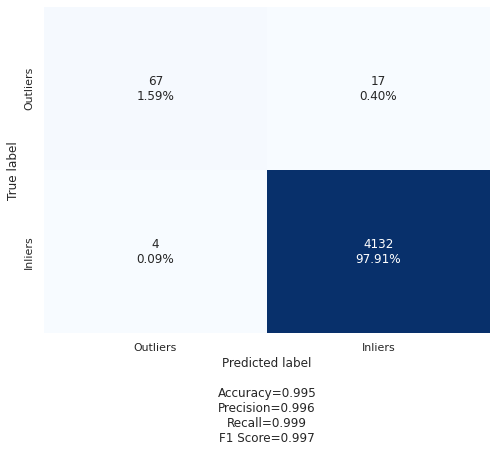

In [ ]:
clf = KNeighborsClassifier(n_neighbors=1, p=1)
clf.fit(X_train, y_train)
originalclass_lr = y_test
predictedclass_lr = clf.predict(X_test)
print(classification_report(originalclass_lr, predictedclass_lr))
print(25*" "+"Confusion Matrix")
cf_matrix = confusion_matrix(originalclass_lr, predictedclass_lr)
categories = ["Outliers", "Inliers"]
make_confusion_matrix(cf_matrix, categories=categories,  figsize=(8,6), cbar=False)

No Skill: ROC AUC=0.500
KNN: ROC AUC=0.898


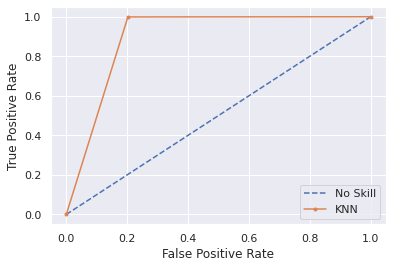

In [ ]:
# generate a no skill prediction (majority class)
y_test_num = [1 if x == 1 else 0 for x in y_test]
ns_probs = [0 for _ in range(len(y_test_num))]
# fit a model
# model = LogisticRegression(solver='lbfgs')
# model.fit(trainX, trainy)
# predict probabilities
lr_probs = clf.predict_proba(X_test)
# keep probabilities for the positive outcome only
lr_probs = lr_probs[:, 1]
# calculate scores
ns_auc = roc_auc_score(y_test_num, ns_probs)
lr_auc = roc_auc_score(y_test_num, lr_probs)
# summarize scores
print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('KNN: ROC AUC=%.3f' % (lr_auc))
# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test_num, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test_num, lr_probs)
# plot the roc curve for the model
pyplot.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
pyplot.plot(lr_fpr, lr_tpr, marker='.', label='KNN')
# axis labels
pyplot.xlabel('False Positive Rate')
pyplot.ylabel('True Positive Rate')
# show the legend
pyplot.legend()
# show the plot
pyplot.show()

We can see that KNN model performed on the test set as good as it did on the training set.

### SVM

In [ ]:
# Variables for average classification report
originalclass_lr = []
predictedclass_lr = []

#Make our custom score
def classification_report_with_accuracy_score(y_true, y_pred):
    originalclass_lr.extend(y_true)
    predictedclass_lr.extend(y_pred)
    return accuracy_score(y_true, y_pred) # return accuracy score

outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=seed)

clf = SVC(random_state=seed, C=0.487, kernel='poly', degree=4, probability=True)

# Nested CV with parameter optimization
nested_score = cross_val_score(clf, X=X_train, y=y_train, cv=outer_cv, scoring=make_scorer(classification_report_with_accuracy_score))

# Average values in classification report for all folds in a K-fold Cross-validation
print(classification_report(originalclass_lr, predictedclass_lr))

              precision    recall  f1-score   support

          -1       0.99      0.55      0.71       246
           1       0.99      1.00      1.00     12414

    accuracy                           0.99     12660
   macro avg       0.99      0.78      0.85     12660
weighted avg       0.99      0.99      0.99     12660



              precision    recall  f1-score   support

          -1       0.98      0.55      0.70        84
           1       0.99      1.00      1.00      4136

    accuracy                           0.99      4220
   macro avg       0.98      0.77      0.85      4220
weighted avg       0.99      0.99      0.99      4220

                         Confusion Matrix


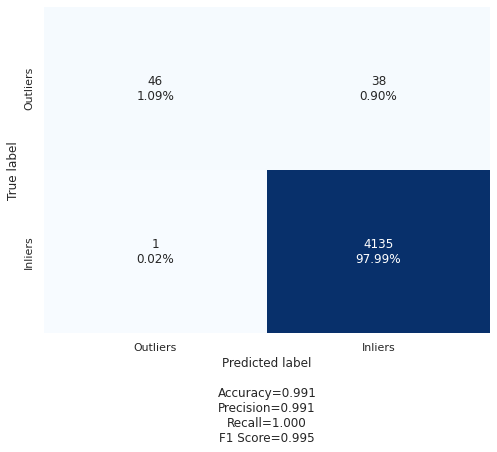

In [ ]:
clf = SVC(random_state=seed, C=0.487, kernel='poly', degree=4, probability=True)
clf.fit(X_train, y_train)
originalclass_lr = y_test
predictedclass_lr = clf.predict(X_test)
print(classification_report(originalclass_lr, predictedclass_lr))
print(25*" "+"Confusion Matrix")
cf_matrix = confusion_matrix(originalclass_lr, predictedclass_lr)
categories = ["Outliers", "Inliers"]
make_confusion_matrix(cf_matrix, categories=categories,  figsize=(8,6), cbar=False)

No Skill: ROC AUC=0.500
SVM: ROC AUC=0.960


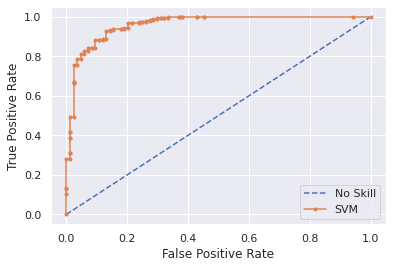

In [ ]:
# generate a no skill prediction (majority class)
y_test_num = [1 if x == 1 else 0 for x in y_test]
ns_probs = [0 for _ in range(len(y_test_num))]
# fit a model
# model = LogisticRegression(solver='lbfgs')
# model.fit(trainX, trainy)
# predict probabilities
lr_probs = clf.predict_proba(X_test)
# keep probabilities for the positive outcome only
lr_probs = lr_probs[:, 1]
# calculate scores
ns_auc = roc_auc_score(y_test_num, ns_probs)
lr_auc = roc_auc_score(y_test_num, lr_probs)
# summarize scores
print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('SVM: ROC AUC=%.3f' % (lr_auc))
# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test_num, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test_num, lr_probs)
# plot the roc curve for the model
pyplot.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
pyplot.plot(lr_fpr, lr_tpr, marker='.', label='SVM')
# axis labels
pyplot.xlabel('False Positive Rate')
pyplot.ylabel('True Positive Rate')
# show the legend
pyplot.legend()
# show the plot
pyplot.show()

Despite having a lower ROC AUC score KNN performed better in all other metric and clearly is the best model among the supervise model. Thus, I would use KNN model with features without none-linear transformation.

## 6.2 Unsupervised Models

### DR for visualization

In [ ]:
dim_reducer = PCA(n_components=2)
X_reduced = dim_reducer.fit_transform(X)
X_reduced.shape

(16880, 2)

In [ ]:
dim_reducer = PCA(n_components=2)
X_poly_reduced = dim_reducer.fit_transform(X_poly)
X_poly_reduced.shape

(16880, 2)

### Isolation Forest

In [ ]:
iso_clt_opt = IsolationForest(random_state=seed, n_estimators=50, max_samples=400, contamination=0.00316, max_features=0.19545)
cluster_labels = iso_clt_opt.fit_predict(X)

silhouette_sc = silhouette_score(X, cluster_labels)
db_sc = davies_bouldin_score(X, cluster_labels)
ch_sc = calinski_harabasz_score(X, cluster_labels)
outlier_percentage = np.count_nonzero(cluster_labels == -1)/np.count_nonzero(cluster_labels != 0)
print(
    "For Isolation Forest",
    "\nThe metrics are",
    "\nOutlier percentage is :", outlier_percentage,
    "\nSilhouette score is :", silhouette_sc,
    "\nDavies Bouldin score is :", db_sc,
    "\nCalinski Harabasz score is :", ch_sc
)

For Isolation Forest 
The metrics are 
Outlier percentage is : 0.003199052132701422 
Silhouette score is : 0.38950270350317134 
Davies Bouldin score is : 1.82570950579071 
Calinski Harabasz score is : 92.3948617982214


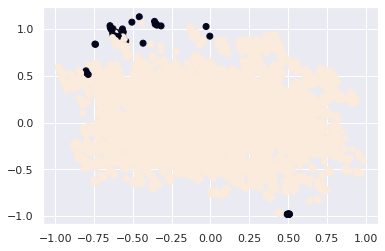

In [ ]:
plt.scatter(X_reduced[:,0], X_reduced[:,1], c=cluster_labels)

Here I will also check with true values to see if the results were good, however this part cannot be used in decision making of unsupervised learning as in real case of unsupervised problem the true values will not be available.

              precision    recall  f1-score   support

          -1       0.26      0.04      0.07       330
           1       0.98      1.00      0.99     16550

    accuracy                           0.98     16880
   macro avg       0.62      0.52      0.53     16880
weighted avg       0.97      0.98      0.97     16880

                         Confusion Matrix


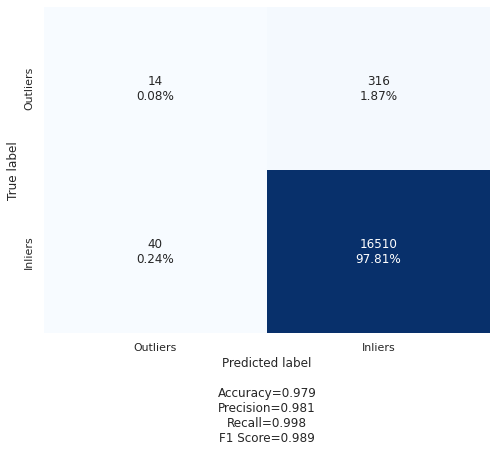

In [ ]:
iso_clt = IsolationForest(random_state=seed, n_estimators=50, max_samples=400, contamination=0.00316, max_features=0.19545)
iso_clt.fit(X)
originalclass_lr = y
predictedclass_lr = iso_clt.predict(X)
print(classification_report(originalclass_lr, predictedclass_lr))
print(25*" "+"Confusion Matrix")
cf_matrix = confusion_matrix(originalclass_lr, predictedclass_lr)
categories = ["Outliers", "Inliers"]
make_confusion_matrix(cf_matrix, categories=categories,  figsize=(8,6), cbar=False)

### One-class SVM

In [ ]:
ocsvm_clt_opt = OneClassSVM(nu=0.01187, gamma=0.07717)
cluster_labels = ocsvm_clt_opt.fit_predict(X_poly)

silhouette_sc = silhouette_score(X_poly, cluster_labels)
db_sc = davies_bouldin_score(X_poly, cluster_labels)
ch_sc = calinski_harabasz_score(X_poly, cluster_labels)
outlier_percentage = np.count_nonzero(cluster_labels == -1)/np.count_nonzero(cluster_labels != 0)
print(
    "For One Class SVM",
    "\nThe metrics are",
    "\nOutlier percentage is :", outlier_percentage,
    "\nSilhouette score is :", silhouette_sc,
    "\nDavies Bouldin score is :", db_sc,
    "\nCalinski Harabasz score is :", ch_sc
)

For One Class SVM 
The metrics are 
Outlier percentage is : 0.011966824644549763 
Silhouette score is : 0.37451201408975426 
Davies Bouldin score is : 4.799160140865592 
Calinski Harabasz score is : 68.20073694983832


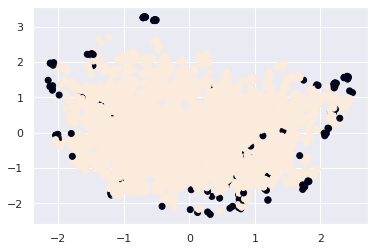

In [ ]:
plt.scatter(X_poly_reduced[:,0], X_poly_reduced[:,1], c=cluster_labels)

Here I will also check with true values to see if the results were good, however this part cannot be used in decision making of unsupervised learning as in real case of unsupervised problem the true values will not be available.

              precision    recall  f1-score   support

          -1       0.25      0.15      0.19       330
           1       0.98      0.99      0.99     16550

    accuracy                           0.97     16880
   macro avg       0.62      0.57      0.59     16880
weighted avg       0.97      0.97      0.97     16880

              precision    recall  f1-score   support

          -1       0.25      0.15      0.19       330
           1       0.98      0.99      0.99     16550

    accuracy                           0.97     16880
   macro avg       0.62      0.57      0.59     16880
weighted avg       0.97      0.97      0.97     16880

                         Confusion Matrix


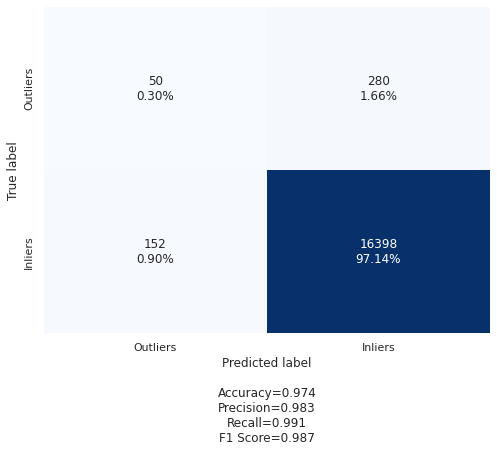

In [ ]:
ocsvm_clt_opt = OneClassSVM(nu=0.01187, gamma=0.07717)
ocsvm_clt_opt.fit(X_poly)
originalclass_lr = y
predictedclass_lr = ocsvm_clt_opt.predict(X_poly)
print(classification_report(originalclass_lr, predictedclass_lr))
print(25*" "+"Confusion Matrix")
cf_matrix = confusion_matrix(originalclass_lr, predictedclass_lr)
categories = ["Outliers", "Inliers"]
make_confusion_matrix(cf_matrix, categories=categories,  figsize=(8,6), cbar=False)

The final decision makeing in this case would be quite hard, based on Silhouette score Isolation Forest performed better and it was using the regular data without none-linear transformation, thus the model was faster to train and lighter for later use.
At the same time if we had any idea beforehand about the percentage of outliers in the data, I think we would choose the One-class SVM model, as the Isolation Forest found very few outliers.
To sum up, if I had no info about outliers percentage, I would choose the Isolation Forest model with features without none-linear transformation.